## Notebook for Fetal Gut Stem cells characterization

- **Developed by:** Anna Maguza
- **Place:** Wuerzburg Institute for System Immunology
- **Date:** 14th November 2023

### Load required modules

In [1]:
import numpy as np
import scipy as sp
import pandas as pd
import scanpy as sc

import matplotlib.pyplot as plt

In [2]:
%matplotlib inline
plt.rcParams["pdf.fonttype"] = 42
plt.rcParams["ps.fonttype"] = 42

In [3]:
sc.settings.verbosity = 3
sc.logging.print_versions()
sc.settings.set_figure_params(dpi = 180, color_map = 'magma_r', dpi_save = 300, vector_friendly = True, format = 'svg')

-----
anndata     0.9.2
scanpy      1.9.5
-----
PIL                         10.0.1
anyio                       NA
arrow                       1.3.0
asttokens                   NA
attr                        23.1.0
attrs                       23.1.0
babel                       2.13.0
backcall                    0.2.0
certifi                     2023.07.22
cffi                        1.16.0
charset_normalizer          3.3.0
colorama                    0.4.6
comm                        0.1.4
cycler                      0.10.0
cython_runtime              NA
dateutil                    2.8.2
debugpy                     1.8.0
decorator                   5.1.1
defusedxml                  0.7.1
executing                   2.0.0
fastjsonschema              NA
fqdn                        NA
h5py                        3.9.0
idna                        3.4
igraph                      0.11.2
ipykernel                   6.25.2
ipywidgets                  8.1.1
isoduration                 NA
jedi   

In [4]:
def X_is_raw(adata):
    return np.array_equal(adata.X.sum(axis=0).astype(int), adata.X.sum(axis=0))

### Data Upload


In [5]:
input_path = '/home/amaguza/data/Processed_data/Gut_data/Stem_cells/Fetal_healthy_stem_cells_leiden.h5ad'
adata = sc.read_h5ad(input_path)

In [6]:
# Return to raw counts 
adata_raw = adata.raw.copy()

In [7]:
adata = sc.AnnData(X=adata_raw.X, obs=adata.obs, var=adata_raw.var, uns=adata.uns, obsm=adata.obsm, varm=adata.varm, obsp = adata.obsp)

In [8]:
X_is_raw(adata)

True

In [9]:
# Save raw data
adata.raw = adata

### Check the enrichment of Fetal Stem Cells markers

In [10]:
stem_cells_markers = ['LGR5', 'BMI1', 'GJA1', 'TACSTD2', 'SOX2', 'NANOG', 'LY6H', 'SPP1', 'DCLK1',
                                            'CD44', 'DCLK1', 'TERT', 'ALCAM', 'ASCL2', 'BMPR1A', 'EPHB2']
# perform gene enrichment analysis on the stem cells markers
sc.tl.score_genes(adata, stem_cells_markers, score_name = "Stem_cells_markers_score")

computing score 'Stem_cells_markers_score'
    finished: added
    'Stem_cells_markers_score', score of gene set (adata.obs).
    500 total control genes are used. (0:00:00)


In [16]:
sc.set_figure_params(dpi=300)
sc.pl.umap(adata, frameon = False, color = ['cluster', 'LGR5', 'BMI1', 'GJA1', 'TACSTD2', 'SOX2', 'NANOG', 'LY6H', 'SPP1', 'DCLK1',
                                            'CD44', 'DCLK1', 'TERT', 'ALCAM', 'ASCL2', 'BMPR1A', 'EPHB2', 'Stem_cells_markers_score'], color_map='magma_r', size = 5, legend_fontsize = 5, ncols = 4)

/home/amaguza/miniforge3/envs/scanpy_env/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/amaguza/miniforge3/envs/scanpy_env/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/amaguza/miniforge3/envs/scanpy_env/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/amaguza/miniforge3/envs/scanpy_env/lib/python3.11/site-packages/scanpy/pl

In [15]:
sc.tl.score_genes(adata, stem_cells_markers, score_name = "Stem_cells_markers_score")

computing score 'Stem_cells_markers_score'
    finished: added
    'Stem_cells_markers_score', score of gene set (adata.obs).
    942 total control genes are used. (0:00:00)


In [20]:
# Create a violin plot
sc.pl.violin(adata, ['LGR5', 'BMI1', 'GJA1', 'TACSTD2', 'SOX2', 'NANOG', 'LY6H', 'SPP1'], groupby='cluster', rotation=90)

/home/amaguza/miniforge3/envs/scanpy_env/lib/python3.11/site-packages/scanpy/plotting/_anndata.py:770: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(adata.obs[groupby]):
/home/amaguza/miniforge3/envs/scanpy_env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/amaguza/miniforge3/envs/scanpy_env/lib/python3.11/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
/home/amaguza/miniforge3/envs/scanpy_env/lib/python

In [21]:
# Create a violin plot
sc.pl.violin(adata, ['DCLK1', 'CD44', 'DCLK1', 'TERT', 'ALCAM', 'ASCL2', 'BMPR1A', 'EPHB2'], groupby='cluster', rotation=90)

/home/amaguza/miniforge3/envs/scanpy_env/lib/python3.11/site-packages/scanpy/plotting/_anndata.py:770: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(adata.obs[groupby]):
/home/amaguza/miniforge3/envs/scanpy_env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/amaguza/miniforge3/envs/scanpy_env/lib/python3.11/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
/home/amaguza/miniforge3/envs/scanpy_env/lib/python

/home/amaguza/miniforge3/envs/scanpy_env/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/home/amaguza/miniforge3/envs/scanpy_env/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/home/amaguza/miniforge3/envs/scanpy_env/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:748: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be igno

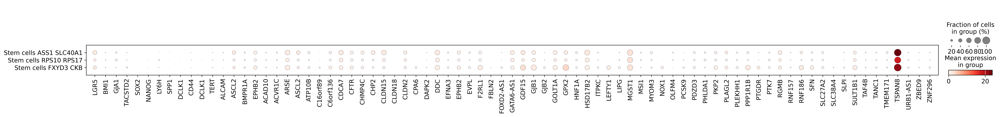

In [14]:
stem_cells_markers = ['LGR5', 'BMI1', 'GJA1', 'TACSTD2', 'SOX2', 'NANOG', 'LY6H', 'SPP1', 'DCLK1', 'CD44', 'DCLK1', 'TERT', 'ALCAM', 'ASCL2', 'BMPR1A', 'EPHB2', 'ACAD10', 
                      'ACVR1C', 'ARSE', 'ASCL2', 'ATP10B', 'C16orf89', 'C6orf136', 'CDCA7', 'CFTR', 'CHMP4C', 'CHP2', 'CLDN15', 'CLDN18', 'CLDN2', 'CPA6', 'DAPK2', 'DDC', 
                      'EFNA3', 'EPHB2', 'EVPL', 'F2RL1', 'FBLN2', 'FOXD2-AS1', 'GATA6-AS1', 'GDF15', 'GJB1', 'GJB2', 'GOLT1A', 'GPX2', 'HNF1A', 'HSD17B2', 'ITPKC', 
                      'LEFTY1', 'LIPG', 'MGST1', 'MSI1', 'MYOM3', 'NOX1', 'OLFM4', 'PCSK9', 'PDZD3', 'PHLDA1', 'PKP2', 'PLAGL2', 'PLEKHH1', 
                      'PPP1R1B', 'PTGDR', 'PTK7', 'RGMB', 'RNF157', 'RNF186', 'SFN', 'SLC27A2', 'SLC38A4', 'SLPI', 'SULT1B1', 'TAF4B', 'TANC1', 'TMEM171', 'TSPAN8', 
                      'URB1-AS1', 'ZBED9', 'ZNF296']

sc.pl.dotplot(adata, stem_cells_markers, groupby='cluster')